# This cat does not exist
__Суммарное количество баллов: 10__

__Решение отправлять на `ml.course.practice@gmail.com`__

__Тема письма: `[ML][MS][HW06] <ФИО>`, где вместо `<ФИО>` указаны фамилия и имя__

Цель этого задания - создать котов, которых не существует. В ходе данного задания вы обучите DCGAN и VAE, которые являются одними из первых генеративных моделей. Для этого задания вам наверняка потребуется GPU с CUDA, поэтому рекомендуется использовать Google Colab.

In [ ]:
import torch
from torch import nn
from torch.optim import Adam
from torch.nn import functional as F
from torch.utils.data import Dataset, DataLoader
import os 
import cv2
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import random
import numpy as np

%matplotlib inline

In [ ]:
def random_noise(batch_size, channels, side_size):
    return torch.randn(batch_size, channels, side_size, side_size).cuda()

def imagewide_average(x):
    return x.mean(dim=(-1, -2))
    # 0 - width
    # 1 - concatenate rows (column-wise mean)
    # 2 - concatenate columns (row-wise mean)

In [ ]:
def visualise(imgs, rows=2):
    imgs = (imgs.transpose(1, 3) + 1) / 2
    imgs = torch.cat([imgs[i::rows] for i in range(rows)], dim=1)
    cols = len(imgs)
    imgs = (torch.cat(list(imgs), dim=1)).cpu().numpy()[:, :, ::-1]
    plt.figure(figsize=(cols*1.5, rows*1.5))
    plt.imshow(imgs)
    plt.axis('off')
    plt.tight_layout()
    plt.show()

In [ ]:
class CatDataset(Dataset):
    def __init__(self, path_to_dataset="/cat_136", size=64):
        self.photo_names = os.listdir(path_to_dataset)
        self.path_base = path_to_dataset
        self.size = size
    
    def __getitem__(self, index):
        path = self.path_base + "/" + self.photo_names[index]
        img = cv2.imread(path) # 136 x 136
        crop_rate = 8
        x_crop = random.randint(0, crop_rate)
        y_crop = random.randint(0, crop_rate)
        img = img[x_crop:136 - crop_rate + x_crop, y_crop:136 - crop_rate + y_crop]
        img = cv2.resize(img, (self.size, self.size), interpolation=cv2.INTER_CUBIC)
        return 2 * torch.tensor(img).float().transpose(0, 2) / 255. - 1
    
    def __len__(self):
        return len(self.photo_names)

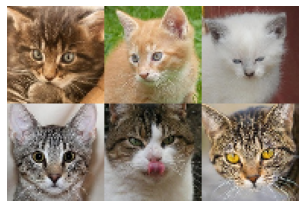

In [ ]:
dataset = CatDataset()
visualise(torch.cat([dataset[i].unsqueeze(0) for i in [3, 15, 182, 592, 394, 2941]], dim=0))

### Задание 1 (2 балла)
Для начала реализуем генератор для нашего DCGAN. Предлагается использовать следующую архитектуру:

![](imgs/DCGAN.png)

Для ее реализации вам потребуются модули `nn.BatchNorm2d`, `nn.Conv2d`, `nn.ConvTranspose2D`, `nn.ReLU`, а также функция `F.interpolate`.

#### Методы
* `__init__` - принимает на вход `start_size`, `latent_channels`, `start_channels` и `upsamplings`. Первые два аргумента отвечают за размер случайного шума, из которого в последствии будет сгенерирована картинка. `start_channels` отвечает за то, сколько каналов должно быть в картинке перед тем, как к ней будут применены upsampling блоки. `upsamplings` - это количество upsampling блоков, которые должны быть применены к картинке. В каждом таком блоке количество каналов уменьшается в два раза.


* `forward` - принимает на вход `batch_size`, генерирует `batch_size` картинок из случайного шума.

In [ ]:
class UpsamplingBlock(nn.Module):
    def __init__(self, c_in: int):
        super().__init__()
        self.conv = nn.ConvTranspose2d(c_in, c_in // 2, kernel_size=4, 
                                       stride=2, padding=1, bias=False)
        self.norm = nn.BatchNorm2d(c_in // 2)
        self.relu = nn.ReLU()

    def forward(self, z: torch.Tensor) -> torch.Tensor:
        return self.relu(self.norm(self.conv(z)))


In [ ]:
class Generator(nn.Module):
    def __init__(self, start_size=2, latent_channels=32, start_channels=1024, upsamplings=6):
        super().__init__()
        self.latent_channels = latent_channels
        self.start_size = start_size

        self.conv1 = nn.Conv2d(latent_channels, start_channels, 
                               kernel_size=1, stride=1, bias=False)
        self.upsamplings = nn.Sequential(*[
            UpsamplingBlock(start_channels // 2 ** i) 
            for i in range(upsamplings)])
        self.conv2 = nn.Conv2d(start_channels // 2 ** upsamplings, 3, 
                               kernel_size=1, stride=1, bias=False)
        self.tanh = nn.Tanh()

    def forward(self, batch_size: int):
        z = random_noise(batch_size, self.latent_channels, self.start_size).cuda()
        z = self.conv1(z)

        z = self.upsamplings.forward(z)

        return self.tanh(self.conv2(z)) 
        # torch.Tensor batch_size x 3 x (start_size * 2**upsamplings) x (start_size * 2**upsamplings)

### Задание 2 (2 балла)
Теперь реализуем дискриминатор для нашего DCGAN. Предлагается использовать следующую архитектуру:

![](imgs/Disc_DCGAN.png)

Для ее реализации вам потребуются модули `nn.BatchNorm2d`, `nn.Conv2d`, `nn.ReLU` и `nn.Sigmoid`.

#### Методы
* `__init__` - принимает на вход `start_channels` и `downsamplings`. `start_channels` определяет количество каналов, которые должны быть в изображении перед применением downsampling блоков.


* `forward` - принимает на вход `x` - тензор с картинками. Возвращает вектор с размерностью `batch_size`.

In [ ]:
class DownsamplingBlock(nn.Module):
    def __init__(self, c_in: int):
        super().__init__()
        self.conv = nn.Conv2d(c_in, c_in * 2, kernel_size=3, 
                              stride=2, padding=1, bias=False)
        self.norm = nn.BatchNorm2d(c_in * 2)
        self.relu = nn.ReLU()

    def forward(self, z: torch.Tensor):
        return self.relu(self.norm(self.conv(z)))

In [ ]:
class Discriminator(nn.Module):
    def __init__(self, downsamplings=6, start_channels=8):
        super().__init__()
        self.conv = nn.Conv2d(3, start_channels, kernel_size=1, 
                              stride=1, bias=False)
        self.downsamplings = nn.Sequential(*[
            DownsamplingBlock(start_channels * 2 ** i) 
            for i in range(downsamplings)])
        self.linear = nn.Linear(start_channels * 2 ** downsamplings * 2 * 2, 1)
        self.sigmoid = nn.Sigmoid()
        
    def forward(self, x):
        x = self.conv(x)

        x = self.downsamplings.forward(x)
        
        x = x.flatten(start_dim=1)
        return self.sigmoid(self.linear(x)) 
        # torch.Tensor batch_size x 1

In [ ]:
def train_gan():
    generator = Generator()
    discriminator = Discriminator()

    epochs = 120
    visualise_every = 10
    batch_size = 8
    generator.cuda()
    discriminator.cuda()

    gen_optim = Adam(generator.parameters(), lr=1e-4, betas=(0.5, 0.999))
    disc_optim = Adam(discriminator.parameters(), lr=1e-4, betas=(0.5, 0.999))

    dataset = CatDataset(size=128)

    for ep in range(epochs):
        dataloader = DataLoader(dataset, shuffle=True, batch_size=batch_size)
        total_batches = 0
        gen_loss_avg = 0
        disc_loss_avg = 0

        for i, batch in tqdm(enumerate(dataloader), total=(len(dataset) + batch_size) // batch_size):
            if len(batch) < batch_size:
                continue
            total_batches += 1
            # Positive update
            batch = batch.cuda()
            pred = discriminator(batch)
            loss = F.binary_cross_entropy(pred, torch.ones_like(pred))
            disc_optim.zero_grad()
            loss.backward()
            disc_optim.step()
            disc_loss_avg += loss.item()

            # Negative update
            batch = generator(batch_size).detach()
            pred = discriminator(batch)
            loss = F.binary_cross_entropy(pred, torch.zeros_like(pred))
            disc_optim.zero_grad()
            loss.backward()
            disc_optim.step()
            disc_loss_avg += loss.item()

            # Generator update
            batch = generator(batch_size)
            pred = discriminator(batch)
            loss = F.binary_cross_entropy(pred, torch.ones_like(pred))
            gen_optim.zero_grad()
            loss.backward()
            gen_optim.step()
            gen_loss_avg += loss.item()
        
        if (ep + 1) % visualise_every == 0:
            with torch.no_grad():
                visualise(generator(6), rows=2)

        print(f"Epoch {ep+1} | Discriminator loss: {disc_loss_avg / total_batches} | Generator loss: {gen_loss_avg / total_batches}")


Epoch 1 | Discriminator loss: 0.4482413104088884 | Generator loss: 3.809638531867021



Epoch 2 | Discriminator loss: 0.6278576937197529 | Generator loss: 2.993270887906507



Epoch 3 | Discriminator loss: 0.6284358607166193 | Generator loss: 3.1243917009104853



Epoch 4 | Discriminator loss: 0.07725338162635075 | Generator loss: 5.508961574261233



Epoch 5 | Discriminator loss: 0.01831301599606555 | Generator loss: 6.402861275287889



Epoch 6 | Discriminator loss: 0.04554511164644666 | Generator loss: 6.366022493528283



Epoch 7 | Discriminator loss: 0.21595876835485386 | Generator loss: 5.594088768551809



Epoch 8 | Discriminator loss: 0.35653203666067407 | Generator loss: 4.737608785769954



Epoch 9 | Discriminator loss: 0.6586516014342225 | Generator loss: 3.1475077562543174


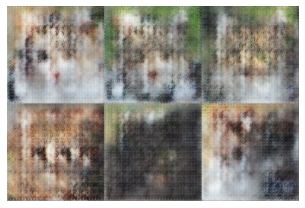

Epoch 10 | Discriminator loss: 0.7899654810823015 | Generator loss: 2.5750587037446335



Epoch 11 | Discriminator loss: 0.782670893033197 | Generator loss: 2.4279382448203815



Epoch 12 | Discriminator loss: 0.7932376306285642 | Generator loss: 2.449432049201142



Epoch 13 | Discriminator loss: 0.7624103907012721 | Generator loss: 2.4679010769132503



Epoch 14 | Discriminator loss: 0.7411352601965241 | Generator loss: 2.5118470765789103



Epoch 15 | Discriminator loss: 0.673798036063813 | Generator loss: 2.5781475648931833



Epoch 16 | Discriminator loss: 0.6430432685749946 | Generator loss: 2.6936057266426383



Epoch 17 | Discriminator loss: 0.6289135088141926 | Generator loss: 2.770382456342626



Epoch 18 | Discriminator loss: 0.5588355559045131 | Generator loss: 2.961184942296573



Epoch 19 | Discriminator loss: 0.5533661735001865 | Generator loss: 3.0373308084766317


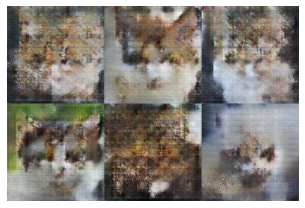

Epoch 20 | Discriminator loss: 0.502613934064255 | Generator loss: 3.190142629124363



Epoch 21 | Discriminator loss: 0.49052243392465505 | Generator loss: 3.1221648288069304



Epoch 22 | Discriminator loss: 0.5072920493424458 | Generator loss: 3.1021280490000795



Epoch 23 | Discriminator loss: 0.44865378576474735 | Generator loss: 3.3984658405045916



Epoch 24 | Discriminator loss: 0.4393540097439231 | Generator loss: 3.3934274286448214



Epoch 25 | Discriminator loss: 0.4449351303728069 | Generator loss: 3.501351344011585



Epoch 26 | Discriminator loss: 0.42313489518161324 | Generator loss: 3.489596617564281



Epoch 27 | Discriminator loss: 0.4184997852270561 | Generator loss: 3.5734975952539383



Epoch 28 | Discriminator loss: 0.38027467524466235 | Generator loss: 3.7410976647960474



Epoch 29 | Discriminator loss: 0.38948745684193337 | Generator loss: 3.691311748038908


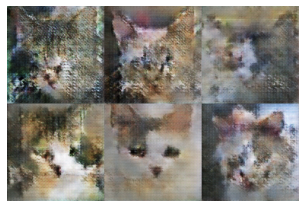

Epoch 30 | Discriminator loss: 0.3954214291519725 | Generator loss: 3.7378179919182886



Epoch 31 | Discriminator loss: 0.4001983673694458 | Generator loss: 3.687844978078552



Epoch 32 | Discriminator loss: 0.3529769347363789 | Generator loss: 3.8637960106597182



Epoch 33 | Discriminator loss: 0.33775212599305504 | Generator loss: 3.8777964603826867



Epoch 34 | Discriminator loss: 0.33509108259268766 | Generator loss: 3.922462342133433



Epoch 35 | Discriminator loss: 0.3544582612798283 | Generator loss: 3.8898897894328424



Epoch 36 | Discriminator loss: 0.34059073287867897 | Generator loss: 3.8529732802084515



Epoch 37 | Discriminator loss: 0.3098532337747015 | Generator loss: 3.956962768983397



Epoch 38 | Discriminator loss: 0.34122870585315185 | Generator loss: 4.063582691624298



Epoch 39 | Discriminator loss: 0.312602820992824 | Generator loss: 4.076642137229072


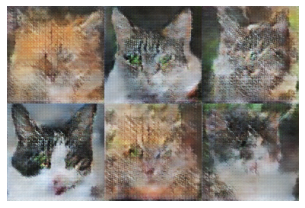

Epoch 40 | Discriminator loss: 0.3111013030501572 | Generator loss: 4.274505395789324



Epoch 41 | Discriminator loss: 0.32492364506129967 | Generator loss: 4.0369780676335285



Epoch 42 | Discriminator loss: 0.2950665675527139 | Generator loss: 4.157371074331473



Epoch 43 | Discriminator loss: 0.31034922923797426 | Generator loss: 4.124384828606007



Epoch 44 | Discriminator loss: 0.3035125256839808 | Generator loss: 4.1904553655326735



Epoch 45 | Discriminator loss: 0.2901105663684417 | Generator loss: 4.294047135929143



Epoch 46 | Discriminator loss: 0.2570818171943361 | Generator loss: 4.481203345408351



Epoch 47 | Discriminator loss: 0.29469052871243784 | Generator loss: 4.413763161309017



Epoch 48 | Discriminator loss: 0.26482276623282364 | Generator loss: 4.446440156109585



Epoch 49 | Discriminator loss: 0.27086352134037894 | Generator loss: 4.5647322993656125


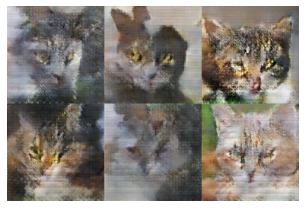

Epoch 50 | Discriminator loss: 0.3093552549148259 | Generator loss: 4.439072892902801



Epoch 51 | Discriminator loss: 0.27746916625658613 | Generator loss: 4.385740626024904



Epoch 52 | Discriminator loss: 0.2811387353987744 | Generator loss: 4.32126093993646



Epoch 53 | Discriminator loss: 0.25503759227589545 | Generator loss: 4.621693077456692



Epoch 54 | Discriminator loss: 0.2740413243953536 | Generator loss: 4.5002097671168935



Epoch 55 | Discriminator loss: 0.2739163293372851 | Generator loss: 4.561828063465423



Epoch 56 | Discriminator loss: 0.2613798558092261 | Generator loss: 4.472003629211313



Epoch 57 | Discriminator loss: 0.24447447793375754 | Generator loss: 4.596729296172813



Epoch 58 | Discriminator loss: 0.2513029300668991 | Generator loss: 4.774185120920587



Epoch 59 | Discriminator loss: 0.2635244168317773 | Generator loss: 4.647181403794274


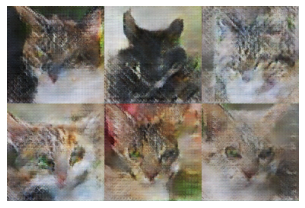

Epoch 60 | Discriminator loss: 0.26304850759218834 | Generator loss: 4.5325368295730275



Epoch 61 | Discriminator loss: 0.23292655817729283 | Generator loss: 4.798009383706202



Epoch 62 | Discriminator loss: 0.25473630159024124 | Generator loss: 4.756688870720982



Epoch 63 | Discriminator loss: 0.2321934462449197 | Generator loss: 4.772439329335408



Epoch 64 | Discriminator loss: 0.24197696464071664 | Generator loss: 4.811982238052054



Epoch 65 | Discriminator loss: 0.2341613760201063 | Generator loss: 4.863382968935907



Epoch 66 | Discriminator loss: 0.2695244749922088 | Generator loss: 4.697247793261679



Epoch 67 | Discriminator loss: 0.22588936940611004 | Generator loss: 4.656193696101259



Epoch 68 | Discriminator loss: 0.22368648906116764 | Generator loss: 4.752588473862002



Epoch 69 | Discriminator loss: 0.22825329672953484 | Generator loss: 4.897863995306981


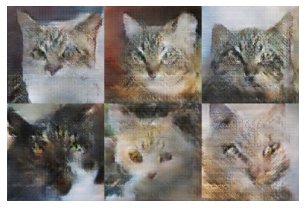

Epoch 70 | Discriminator loss: 0.21878120140178967 | Generator loss: 5.101935631740167



Epoch 71 | Discriminator loss: 0.22925320356152218 | Generator loss: 4.954661707515302



Epoch 72 | Discriminator loss: 0.20314064297493906 | Generator loss: 4.831390300615234



Epoch 73 | Discriminator loss: 0.21396067316704576 | Generator loss: 4.940388824998962



Epoch 74 | Discriminator loss: 0.21147263458092228 | Generator loss: 5.274075212547127



Epoch 75 | Discriminator loss: 0.21681456626183096 | Generator loss: 5.0407716086284715



Epoch 76 | Discriminator loss: 0.2204089038112834 | Generator loss: 5.05010264130853



Epoch 77 | Discriminator loss: 0.19930609097938448 | Generator loss: 5.020728948231069



Epoch 78 | Discriminator loss: 0.24774619639759093 | Generator loss: 5.052746597469223



Epoch 79 | Discriminator loss: 0.19272071234673682 | Generator loss: 5.092773614370304


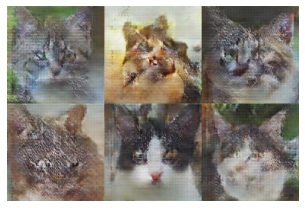

Epoch 80 | Discriminator loss: 0.22017801353868038 | Generator loss: 5.150876529190851



Epoch 81 | Discriminator loss: 0.20444618429205944 | Generator loss: 4.994662591389248



Epoch 82 | Discriminator loss: 0.1945537869046602 | Generator loss: 5.373515205330545



Epoch 83 | Discriminator loss: 0.20410433349354593 | Generator loss: 5.002206558720295



Epoch 84 | Discriminator loss: 0.19318508421257907 | Generator loss: 5.226618516981972



Epoch 85 | Discriminator loss: 0.2004150006341463 | Generator loss: 5.319097500687801



Epoch 86 | Discriminator loss: 0.19933574556541023 | Generator loss: 5.511434877649967



Epoch 87 | Discriminator loss: 0.21377425327374383 | Generator loss: 5.035549247672098



Epoch 88 | Discriminator loss: 0.19292812480715618 | Generator loss: 5.211601497223659



Epoch 89 | Discriminator loss: 0.19935623771307462 | Generator loss: 5.201568301975357


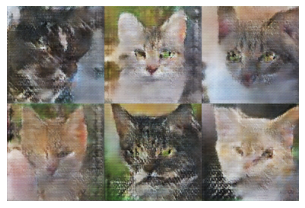

Epoch 90 | Discriminator loss: 0.19075526463192438 | Generator loss: 5.338184565490818



Epoch 91 | Discriminator loss: 0.18763677167537593 | Generator loss: 5.230141767433712



Epoch 92 | Discriminator loss: 0.1786028041520251 | Generator loss: 5.2862096912927505



Epoch 93 | Discriminator loss: 0.18871491783030994 | Generator loss: 5.437011465002199



Epoch 94 | Discriminator loss: 0.19953742353323134 | Generator loss: 5.252796264538854



Epoch 95 | Discriminator loss: 0.1874966757117044 | Generator loss: 5.202665895131064



Epoch 96 | Discriminator loss: 0.21633934800195925 | Generator loss: 5.1914036558385686



Epoch 97 | Discriminator loss: 0.17603513788571026 | Generator loss: 5.3364186154574345



Epoch 98 | Discriminator loss: 0.20564902759929707 | Generator loss: 5.367535335254734



Epoch 99 | Discriminator loss: 0.16621778294628506 | Generator loss: 5.46093555442665


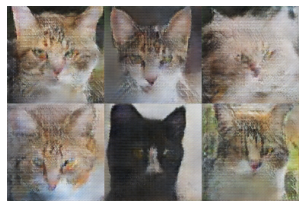

Epoch 100 | Discriminator loss: 0.20659487531720827 | Generator loss: 5.454331393660225



Epoch 101 | Discriminator loss: 0.1759890220855292 | Generator loss: 5.440314468759928



Epoch 102 | Discriminator loss: 0.1807766010063316 | Generator loss: 5.401345590256756



Epoch 103 | Discriminator loss: 0.1796365477967491 | Generator loss: 5.564018901275552



Epoch 104 | Discriminator loss: 0.1656425438445864 | Generator loss: 5.468089754629579



Epoch 105 | Discriminator loss: 0.1728764636650297 | Generator loss: 5.445460545627967



Epoch 106 | Discriminator loss: 0.1648782767923797 | Generator loss: 5.5191364134228005



Epoch 107 | Discriminator loss: 0.1755624951619381 | Generator loss: 5.666624575436856



Epoch 108 | Discriminator loss: 0.1655062603924919 | Generator loss: 5.730584712317271



Epoch 109 | Discriminator loss: 0.16119390296623362 | Generator loss: 5.831151772082222


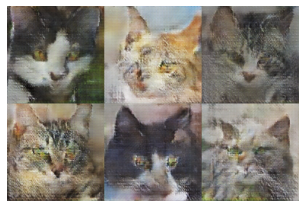

Epoch 110 | Discriminator loss: 0.19120865496085038 | Generator loss: 5.7086120158989235



Epoch 111 | Discriminator loss: 0.15959126437041518 | Generator loss: 5.631238937933253



Epoch 112 | Discriminator loss: 0.16046241980271017 | Generator loss: 5.885125393637959



Epoch 113 | Discriminator loss: 0.1750408988771057 | Generator loss: 5.806260241392236



Epoch 114 | Discriminator loss: 0.13924271800984483 | Generator loss: 5.547245507840044



Epoch 115 | Discriminator loss: 0.18028569567802577 | Generator loss: 5.957281116558158



Epoch 116 | Discriminator loss: 0.14300751388427613 | Generator loss: 5.7881887594920505



Epoch 117 | Discriminator loss: 0.15205161103112408 | Generator loss: 6.005259238229775



Epoch 118 | Discriminator loss: 0.151161547686356 | Generator loss: 5.94568065637202



Epoch 119 | Discriminator loss: 0.16773383127677458 | Generator loss: 5.77854821770828


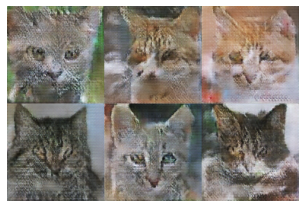

Epoch 120 | Discriminator loss: 0.12979913674936464 | Generator loss: 5.763795429875391


In [ ]:
train_gan()

### Задание 3 (5 баллов)
Теперь посмотрим на другую модель: Variational Autoencoder. В отличие от GAN, в котором генератор пытается себя обмануть дискриминатор, а дискриминатор старается не быть обманутым, VAE решает задачу реконструкции элемента множества X с применением регуляризации в латентном пространстве. 

Полностью архитектура выглядит так:
![](imgs/VAE.png)

Из нее можно выделить две части: Encoder (по изображению возвращает mu и sigma) и Decoder (по случайному шуму восстанавливает изображение). На высоком уровне VAE можно представить так:

![](imgs/VAE_highlevel.png)

В данном задании вам необходимо реализовать полную архитектуру VAE.

#### Методы
* `__init__` - принимает на вход `img_size`, `downsamplings`, `latent_size`, `linear_hidden_size`, `down_channels` и `up_channels`. `img_size` - размер стороны входного изображения. `downsamplings` - количество downsampling (и upsampling) блоков. `latent_size` - размер латентного пространства, в котором будет закодирована картинка. `linear_hidden_size` количество нейронов на скрытом слое полносвязной сети в конце encoder'а. Для полносвязной сети decoder'а это число стоит умножить на 2. `down_channels` - количество каналов, в которое будет преобразовано трехцветное изображение перед применением `downsampling` блоков. `up_channels` - количество каналов, которое должно получиться после применения всех upsampling блоков.

* `forward` - принимает на вход `x`. Считает распределение $N(\mu, \sigma^2)$ и вектор $z \sim N(\mu, \sigma^2)$. Возвращает $x'$ - восстановленную из вектора $z$ картинку и $D_{KL}(N(\mu, \sigma^2), N(0, 1)) = 0.5 \cdot (\sigma^2 + \mu^2 - \log \sigma^2 - 1)$.

* `encode` - принимает на вход `x`. Возвращает вектор из распределения $N(\mu, \sigma^2)$.

* `decode` - принимает на вход `z`. Возвращает восстановленную по вектору картинку.


#### Если хочется улучшить качество
https://arxiv.org/pdf/1906.00446.pdf

In [ ]:
class VAE(nn.Module):
    def __init__(self, img_size=128, downsamplings=5, latent_size=512, 
                 linear_hidden_size=1024, down_channels=8, up_channels=16):
        super().__init__()
        self.latent_size = latent_size
        self.encoding_seq = nn.Sequential(
            nn.Conv2d(3, down_channels, kernel_size=1, stride=1, bias=False),
            *[DownsamplingBlock(down_channels * 2 ** i) 
                                for i in range(downsamplings)],
            nn.Conv2d(down_channels * 2 ** downsamplings,
                               2 * latent_size, kernel_size=1, 
                      stride=1, bias=False),
            nn.Flatten())
        
        self.img_size_down = img_size // 2 ** downsamplings
        self.linear_mu = nn.Sequential(
            nn.Linear(2 * latent_size * self.img_size_down * self.img_size_down, 
                      linear_hidden_size),
            nn.Linear(linear_hidden_size, latent_size))
        
        self.linear_sigma = nn.Sequential(
            nn.Linear(2 * latent_size * self.img_size_down * self.img_size_down, 
                      linear_hidden_size),
            nn.Linear(linear_hidden_size, latent_size))
        
        self.linear_z = nn.Sequential(
            nn.Linear(latent_size, linear_hidden_size * 2),
            nn.Linear(linear_hidden_size * 2, latent_size * self.img_size_down
                      * self.img_size_down))


        c = up_channels * 2 ** downsamplings
        self.decoding_seq = nn.Sequential(
            nn.Conv2d(latent_size, c, kernel_size=1, stride=1, bias=False),
            *[UpsamplingBlock(c // 2 ** i) for i in range(downsamplings)],
            nn.Conv2d(up_channels, 3, kernel_size=1, stride=1, bias=False),
            nn.Tanh())


    def forward(self, x):
        x = self.encoding_seq(x)
        
        mu, sigma = self.linear_mu(x), self.linear_sigma(torch.exp(x))

        norm = torch.randn_like(mu)

        kld = 0.5 * (torch.square(sigma) + torch.square(mu) 
                        - torch.log(torch.square(sigma)) - 1)

        x = mu + norm * sigma
        
        x = self.linear_z(x)
        x = self.decoding_seq(x.view(-1, self.latent_size, 
                                        self.img_size_down, self.img_size_down))
        return x, kld
    
    def encode(self, x):
        x = self.encoding_seq(x)
        mu, sigma = self.linear_mu(x), self.linear_sigma(torch.exp(x))
        z = mu + torch.randn_like(mu) * sigma
        return z
    
    def decode(self, z):
        z = self.linear_z(z)
        return self.decoding_seq(z.view(-1, self.latent_size, 
                                        self.img_size_down, self.img_size_down))

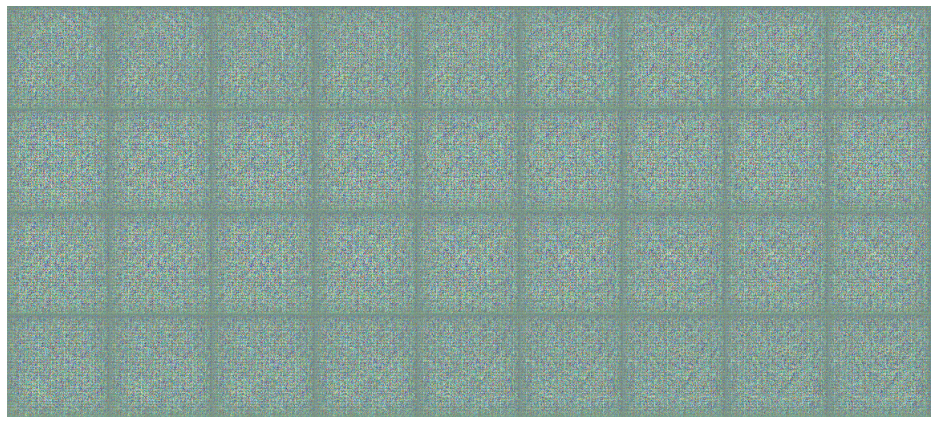

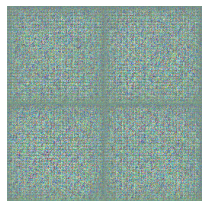


Epoch 1 | Reconstruction loss: 8740.815829259269 | KLD loss: 5798.807845879785



Epoch 2 | Reconstruction loss: 5748.209145113548 | KLD loss: 5843.387242856233



Epoch 3 | Reconstruction loss: 5226.865903866217 | KLD loss: 3562.337801536418



Epoch 4 | Reconstruction loss: 4933.438527741047 | KLD loss: 2602.391557207759



Epoch 5 | Reconstruction loss: 4746.494002253373 | KLD loss: 2359.0082907350907



Epoch 6 | Reconstruction loss: 4568.822184497525 | KLD loss: 2153.902351332007



Epoch 7 | Reconstruction loss: 4457.10046689999 | KLD loss: 2063.026403960234



Epoch 8 | Reconstruction loss: 4300.758761388174 | KLD loss: 2070.755976517008



Epoch 9 | Reconstruction loss: 4125.433350367575 | KLD loss: 2036.981407402465



Epoch 10 | Reconstruction loss: 3988.5647609544835 | KLD loss: 1973.84321831176


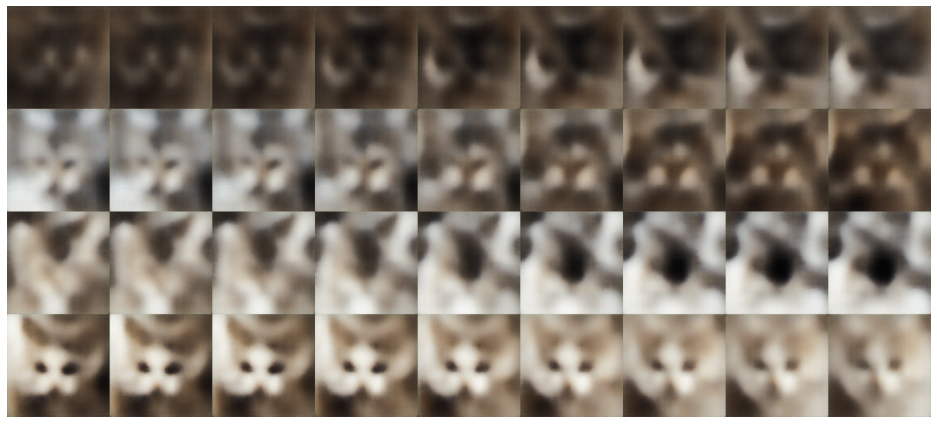

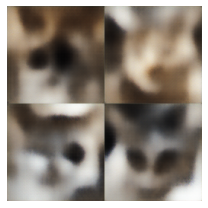


Epoch 11 | Reconstruction loss: 3942.8277045777127 | KLD loss: 1967.1082991132084



Epoch 12 | Reconstruction loss: 3879.0123529848847 | KLD loss: 2228.0141205402633



Epoch 13 | Reconstruction loss: 3765.109380307405 | KLD loss: 2127.615227930294



Epoch 14 | Reconstruction loss: 3746.1700572138247 | KLD loss: 2300.875333987408



Epoch 15 | Reconstruction loss: 3662.1210183090307 | KLD loss: 2269.499356666707



Epoch 16 | Reconstruction loss: 3618.785716939417 | KLD loss: 2186.4605149926606



Epoch 17 | Reconstruction loss: 3566.102429123399 | KLD loss: 2284.142589877111



Epoch 18 | Reconstruction loss: 3513.2817951463026 | KLD loss: 2186.8376578573857



Epoch 19 | Reconstruction loss: 3482.612654976223 | KLD loss: 2206.5294775163165



Epoch 20 | Reconstruction loss: 3480.1613868097343 | KLD loss: 2350.6788438121725


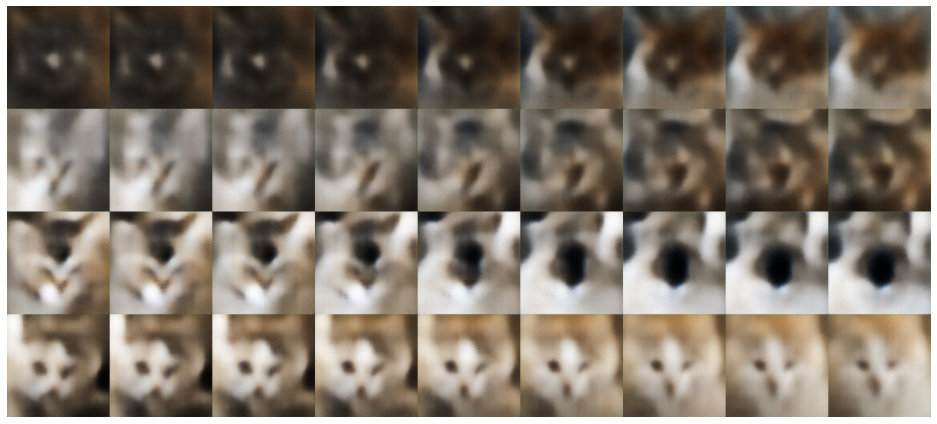

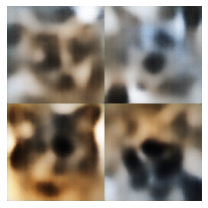


Epoch 21 | Reconstruction loss: 3421.1758153690316 | KLD loss: 2355.919464111328



Epoch 22 | Reconstruction loss: 3382.884278481051 | KLD loss: 2335.0679002844768



Epoch 23 | Reconstruction loss: 3343.553278004901 | KLD loss: 2274.0233286981997



Epoch 24 | Reconstruction loss: 3331.7845822920713 | KLD loss: 2300.149731938143



Epoch 25 | Reconstruction loss: 3331.2904041361367 | KLD loss: 2367.418799548416



Epoch 26 | Reconstruction loss: 3288.7170618661444 | KLD loss: 2492.7376113796827



Epoch 27 | Reconstruction loss: 3280.6417986946817 | KLD loss: 2512.9064839049156



Epoch 28 | Reconstruction loss: 3238.568780365938 | KLD loss: 2434.094830435996



Epoch 29 | Reconstruction loss: 3261.53286648389 | KLD loss: 2492.4133609748033



Epoch 30 | Reconstruction loss: 3187.0856353570216 | KLD loss: 2293.0404185419497


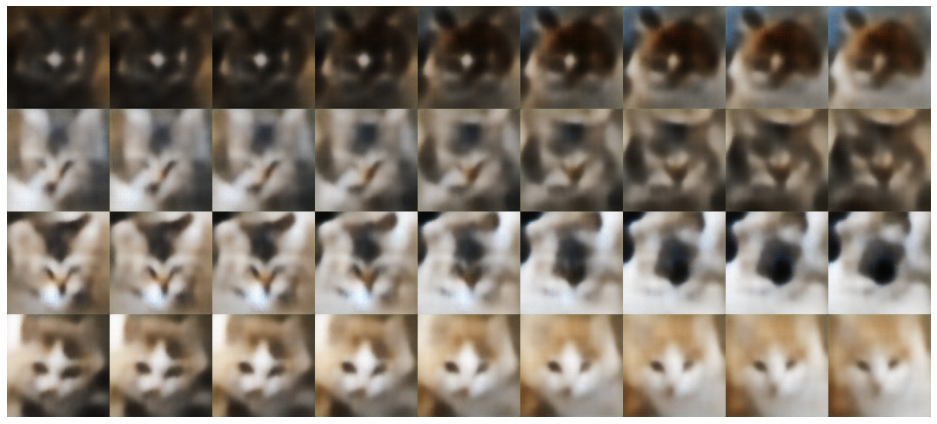

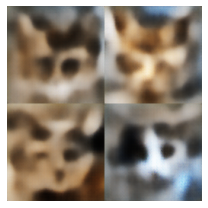


Epoch 31 | Reconstruction loss: 3253.6328589397926 | KLD loss: 2539.667616186675



Epoch 32 | Reconstruction loss: 3164.7678463384973 | KLD loss: 2496.9141872240148



Epoch 33 | Reconstruction loss: 3146.435451720812 | KLD loss: 2381.576239354862



Epoch 34 | Reconstruction loss: 3194.53255239925 | KLD loss: 2534.1243974199947



Epoch 35 | Reconstruction loss: 3258.443117508977 | KLD loss: 2889.7006308988016



Epoch 36 | Reconstruction loss: 3164.3659793071865 | KLD loss: 2726.540859435656



Epoch 37 | Reconstruction loss: 3119.137400941079 | KLD loss: 2621.7037383843654



Epoch 38 | Reconstruction loss: 3111.2296468604427 | KLD loss: 2553.4173800071576



Epoch 39 | Reconstruction loss: 3116.0845158736897 | KLD loss: 2613.2446387628593



Epoch 40 | Reconstruction loss: 3088.516551521254 | KLD loss: 2529.061909740756


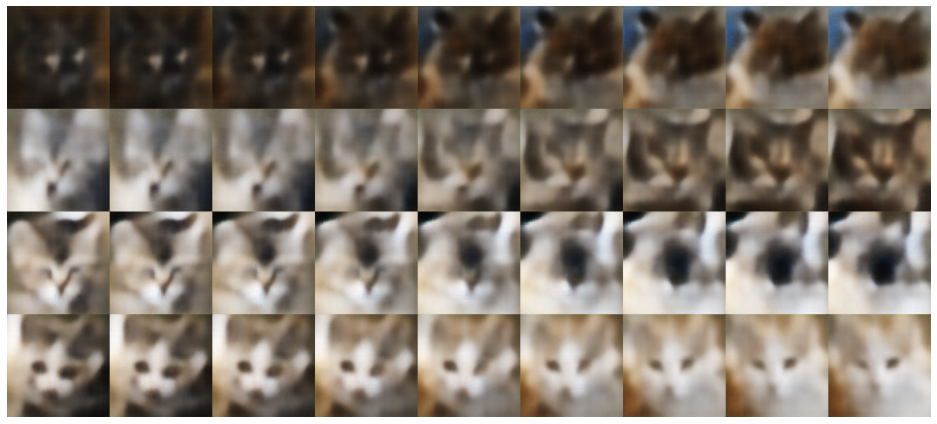

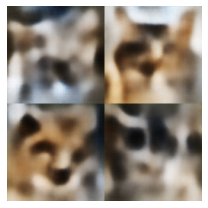


Epoch 41 | Reconstruction loss: 3069.7186495384076 | KLD loss: 2468.3318145941503



Epoch 42 | Reconstruction loss: 3026.4424440372063 | KLD loss: 2466.6050945779552



Epoch 43 | Reconstruction loss: 3054.677352241848 | KLD loss: 2485.3631102757427



Epoch 44 | Reconstruction loss: 3029.7175418071865 | KLD loss: 2418.129670137204



Epoch 45 | Reconstruction loss: 2981.721446161685 | KLD loss: 2345.8120348438715



Epoch 46 | Reconstruction loss: 3109.355012123629 | KLD loss: 2654.638358359011



Epoch 47 | Reconstruction loss: 2995.672433035714 | KLD loss: 2488.0330408700506



Epoch 48 | Reconstruction loss: 2984.6099097210426 | KLD loss: 2435.214159284319



Epoch 49 | Reconstruction loss: 2961.1648485645746 | KLD loss: 2346.804465347195



Epoch 50 | Reconstruction loss: 2947.4721577330406 | KLD loss: 2266.795971414317


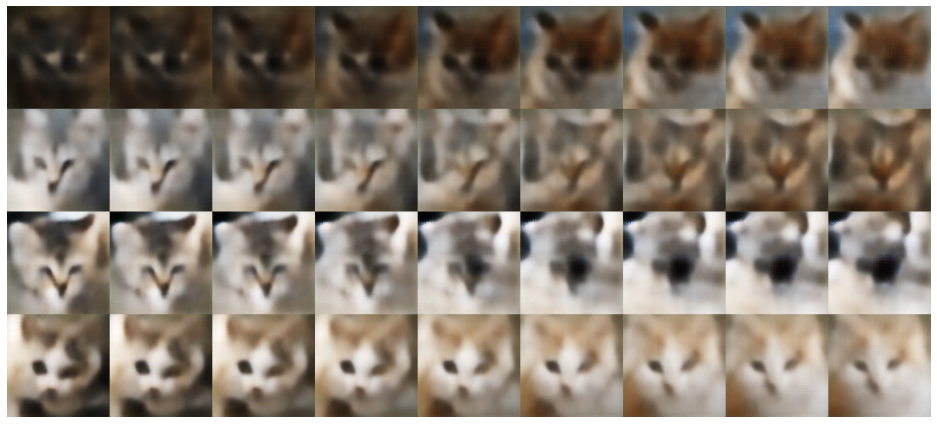

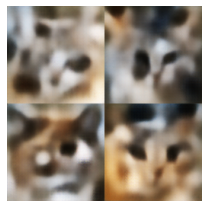


Epoch 51 | Reconstruction loss: 3005.135893069439 | KLD loss: 2396.2598814401567



Epoch 52 | Reconstruction loss: 2921.9941237550343 | KLD loss: 2321.957105174568



Epoch 53 | Reconstruction loss: 2959.274234179384 | KLD loss: 2301.6992028277855



Epoch 54 | Reconstruction loss: 3040.821829470048 | KLD loss: 2660.733643525876



Epoch 55 | Reconstruction loss: 2989.8334496539574 | KLD loss: 2603.573907508613



Epoch 56 | Reconstruction loss: 2906.25527366496 | KLD loss: 2403.271726051473



Epoch 57 | Reconstruction loss: 3022.4989934885725 | KLD loss: 2612.360470031359



Epoch 58 | Reconstruction loss: 2887.7063481111704 | KLD loss: 2393.092015236801



Epoch 59 | Reconstruction loss: 2931.8758069150936 | KLD loss: 2414.8878399392834



Epoch 60 | Reconstruction loss: 3019.481734755617 | KLD loss: 2588.2114075844333


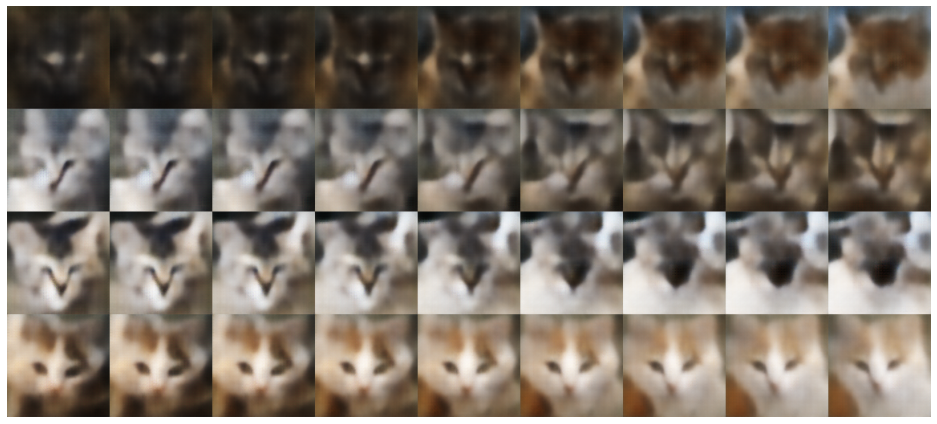

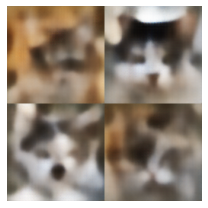


Epoch 61 | Reconstruction loss: 3039.8342131620607 | KLD loss: 2972.9077967294256



Epoch 62 | Reconstruction loss: 2936.096097010263 | KLD loss: 2685.9242409652807



Epoch 63 | Reconstruction loss: 2901.876744619808 | KLD loss: 2563.7120698727435



Epoch 64 | Reconstruction loss: 2893.340325396994 | KLD loss: 2457.4679159792313



Epoch 65 | Reconstruction loss: 2864.3879413486266 | KLD loss: 2409.6866322393003



Epoch 66 | Reconstruction loss: 2838.506214212927 | KLD loss: 2349.4847139157123



Epoch 67 | Reconstruction loss: 2882.435412294376 | KLD loss: 2468.458852068978



Epoch 68 | Reconstruction loss: 2828.1999244453004 | KLD loss: 2319.916424863827



Epoch 69 | Reconstruction loss: 2830.390578181107 | KLD loss: 2288.786127125995



Epoch 70 | Reconstruction loss: 2833.512165140661 | KLD loss: 2246.987052964868


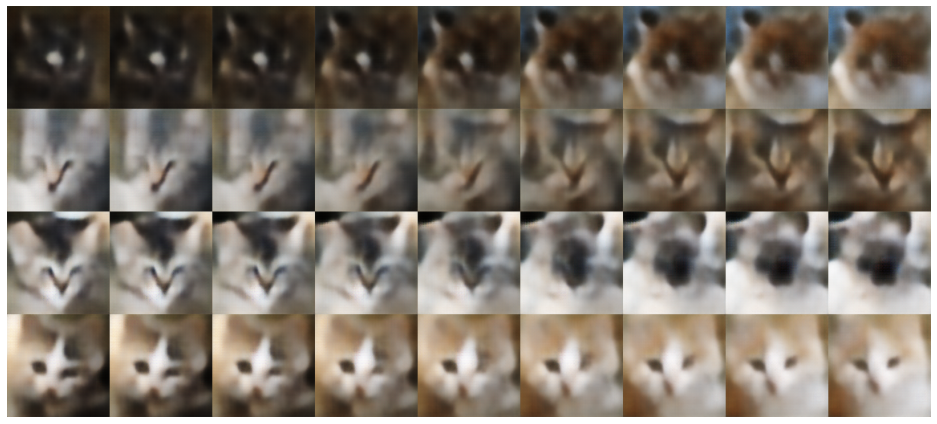

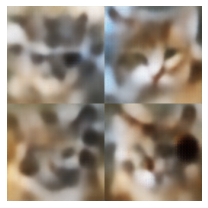


Epoch 71 | Reconstruction loss: 2797.4144088081694 | KLD loss: 2164.8914910547483



Epoch 72 | Reconstruction loss: 2775.7059019100593 | KLD loss: 2088.119758369019



Epoch 73 | Reconstruction loss: 2811.5998065071817 | KLD loss: 2197.526872528266



Epoch 74 | Reconstruction loss: 2862.970363451087 | KLD loss: 2337.0612995787437



Epoch 75 | Reconstruction loss: 2835.129638482325 | KLD loss: 2410.31290165682



Epoch 76 | Reconstruction loss: 2800.4794597744203 | KLD loss: 2280.948472111862



Epoch 77 | Reconstruction loss: 2721.5668035471663 | KLD loss: 2070.718197650791



Epoch 78 | Reconstruction loss: 2734.900995100507 | KLD loss: 2001.032566046863



Epoch 79 | Reconstruction loss: 2761.0299995374976 | KLD loss: 2047.3985597598626



Epoch 80 | Reconstruction loss: 2722.6813437894266 | KLD loss: 2011.0065840253178


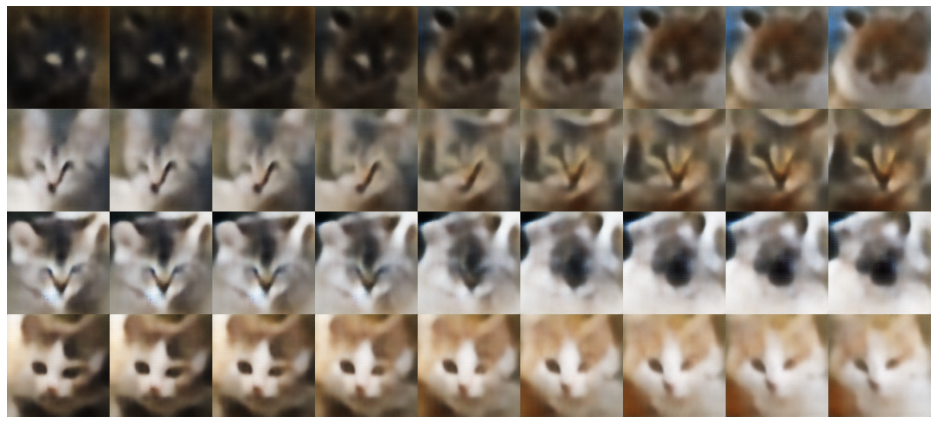

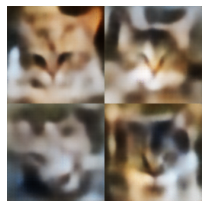


Epoch 81 | Reconstruction loss: 2743.663506738888 | KLD loss: 2065.0207754573466



Epoch 82 | Reconstruction loss: 2755.8506992885045 | KLD loss: 2159.0041881111097



Epoch 83 | Reconstruction loss: 2740.4266073096614 | KLD loss: 2142.6967792392516



Epoch 84 | Reconstruction loss: 2691.773636906784 | KLD loss: 2052.4282998031713



Epoch 85 | Reconstruction loss: 2724.772702803523 | KLD loss: 2038.210527313422



Epoch 86 | Reconstruction loss: 2661.1225917650304 | KLD loss: 1944.3318682368497



Epoch 87 | Reconstruction loss: 2669.364480154855 | KLD loss: 1966.1167701105153



Epoch 88 | Reconstruction loss: 2700.1858873071137 | KLD loss: 1986.7392170592125



Epoch 89 | Reconstruction loss: 2663.499651796329 | KLD loss: 1934.5376643779116



Epoch 90 | Reconstruction loss: 2654.521377658252 | KLD loss: 1924.4150212447835


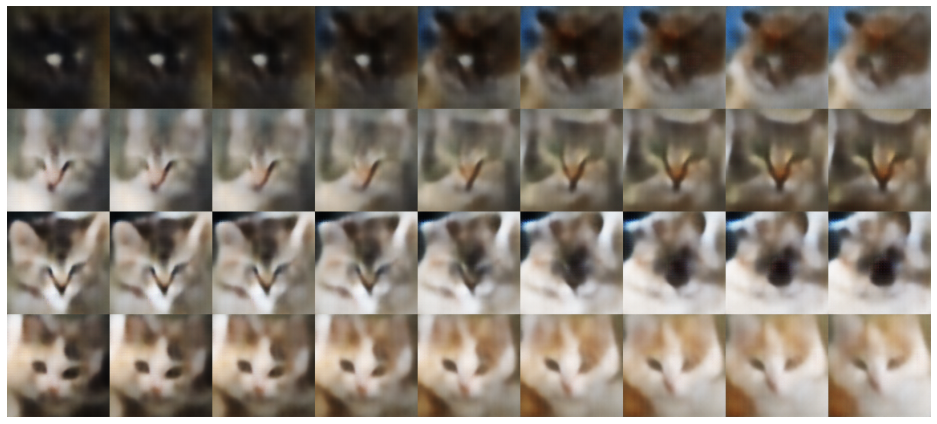

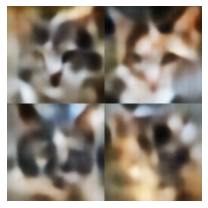


Epoch 91 | Reconstruction loss: 2633.406878169279 | KLD loss: 1859.5910066403217



Epoch 92 | Reconstruction loss: 2661.3887611531322 | KLD loss: 1989.507186415773



Epoch 93 | Reconstruction loss: 2658.7737256162654 | KLD loss: 1993.1714714476782



Epoch 94 | Reconstruction loss: 2621.81464836168 | KLD loss: 1917.1142583811504



Epoch 95 | Reconstruction loss: 2651.6430743673573 | KLD loss: 1918.1307668745148



Epoch 96 | Reconstruction loss: 2581.959561555282 | KLD loss: 1822.6206177895112



Epoch 97 | Reconstruction loss: 2599.1658211465206 | KLD loss: 1820.5660364376092



Epoch 98 | Reconstruction loss: 2591.9151717476225 | KLD loss: 1808.8035454601975



Epoch 99 | Reconstruction loss: 2563.9122445242747 | KLD loss: 1753.5389948305876



Epoch 100 | Reconstruction loss: 2553.5806632663894 | KLD loss: 1673.9400530513028


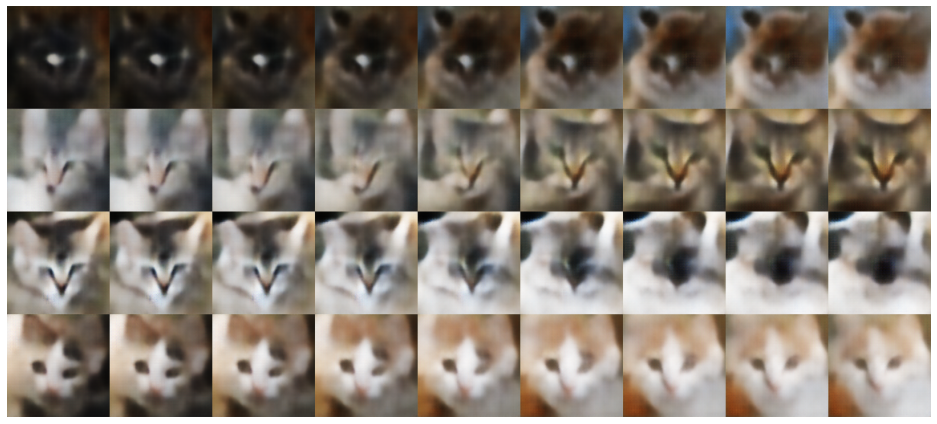

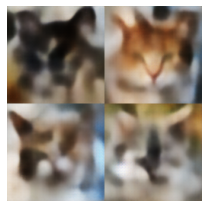


Epoch 101 | Reconstruction loss: 2556.6792831894772 | KLD loss: 1667.1782023743813



Epoch 102 | Reconstruction loss: 2565.173581141122 | KLD loss: 1737.7469266334676



Epoch 103 | Reconstruction loss: 2557.7399889075236 | KLD loss: 1705.4549429757255



Epoch 104 | Reconstruction loss: 2577.3085835142906 | KLD loss: 1790.1689297693856



Epoch 105 | Reconstruction loss: 2559.0484945166927 | KLD loss: 1834.2007165754803



Epoch 106 | Reconstruction loss: 2526.9501384474474 | KLD loss: 1740.6489964834652



Epoch 107 | Reconstruction loss: 2494.3873736458536 | KLD loss: 1624.7260706172967



Epoch 108 | Reconstruction loss: 2532.2209197808497 | KLD loss: 1646.5700439074026



Epoch 109 | Reconstruction loss: 2529.211141645538 | KLD loss: 1681.3791202521472



Epoch 110 | Reconstruction loss: 2512.074637276786 | KLD loss: 1649.1453002550588


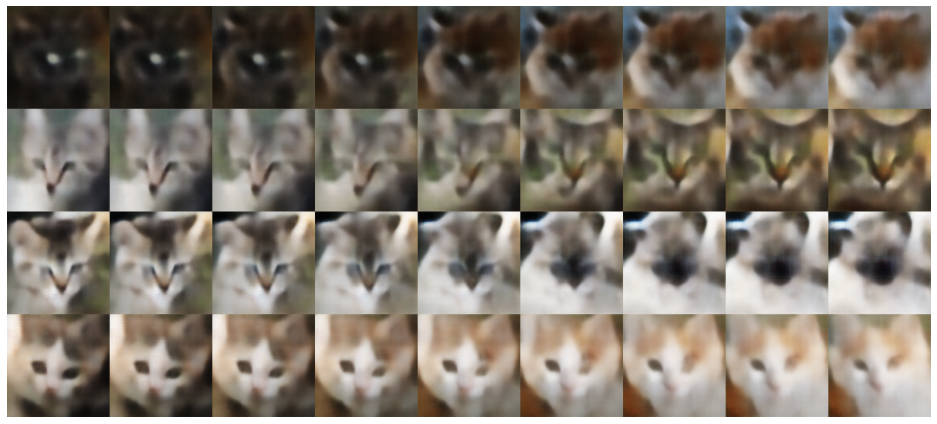

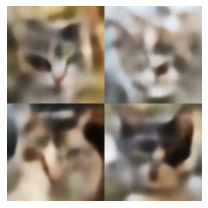


Epoch 111 | Reconstruction loss: 2518.693873624624 | KLD loss: 1680.4708058611948



Epoch 112 | Reconstruction loss: 2474.259498738354 | KLD loss: 1614.267754785763



Epoch 113 | Reconstruction loss: 2503.2238915484886 | KLD loss: 1599.2048499065897



Epoch 114 | Reconstruction loss: 2494.6950274165374 | KLD loss: 1644.866889148025



Epoch 115 | Reconstruction loss: 2479.0629998438108 | KLD loss: 1606.2624498450239



Epoch 116 | Reconstruction loss: 2485.3900984296147 | KLD loss: 1616.9012121354572



Epoch 117 | Reconstruction loss: 2469.4155281019507 | KLD loss: 1600.558178256017



Epoch 118 | Reconstruction loss: 2500.7146968486145 | KLD loss: 1656.7940609381067



Epoch 119 | Reconstruction loss: 2498.296754256539 | KLD loss: 1738.4729265485491



Epoch 120 | Reconstruction loss: 2439.2101929469136 | KLD loss: 1655.650686891923


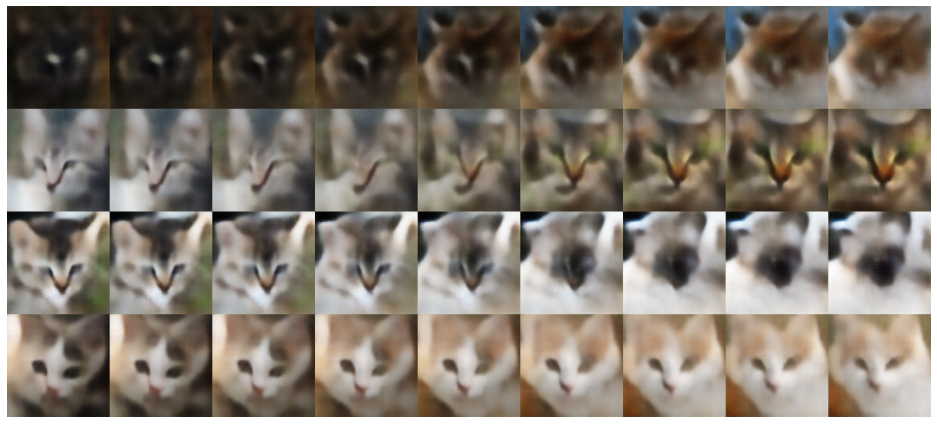

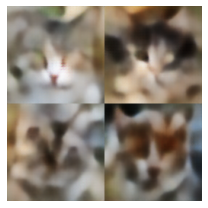


Epoch 121 | Reconstruction loss: 2450.027015828198 | KLD loss: 1569.7043043811868



Epoch 122 | Reconstruction loss: 2469.5886080724113 | KLD loss: 1629.8821293611704



Epoch 123 | Reconstruction loss: 2444.634182189562 | KLD loss: 1576.2953314929275



Epoch 124 | Reconstruction loss: 2427.969418164366 | KLD loss: 1531.9277768342392



Epoch 125 | Reconstruction loss: 2539.1398065223457 | KLD loss: 1721.3886292262107



Epoch 126 | Reconstruction loss: 2450.7859023194874 | KLD loss: 1731.7003177619129



Epoch 127 | Reconstruction loss: 2435.971233865489 | KLD loss: 1650.5210019698054



Epoch 128 | Reconstruction loss: 2416.6485952057456 | KLD loss: 1607.476994484848



Epoch 129 | Reconstruction loss: 2409.4326319724137 | KLD loss: 1546.4995200589576



Epoch 130 | Reconstruction loss: 2417.4449625903776 | KLD loss: 1546.8364532660253


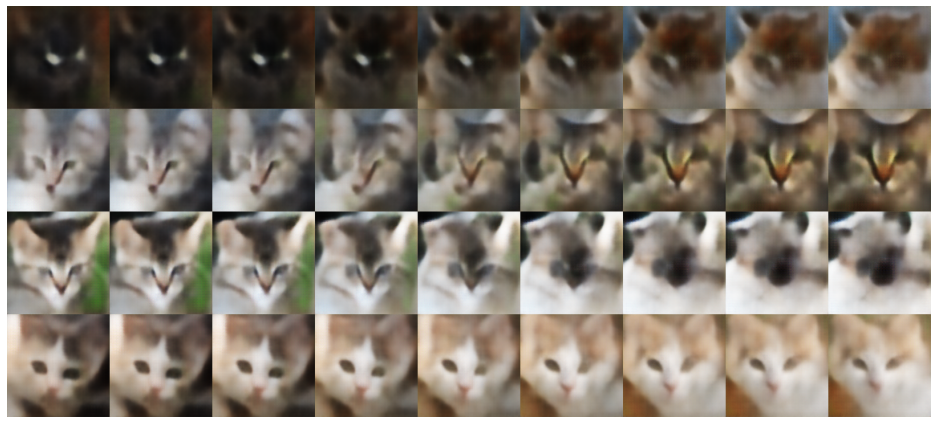

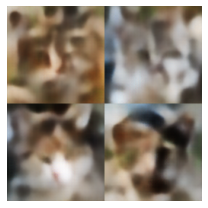


Epoch 131 | Reconstruction loss: 2423.1657220117795 | KLD loss: 1537.9089059770477



Epoch 132 | Reconstruction loss: 2490.1248021096176 | KLD loss: 1650.4674458947982



Epoch 133 | Reconstruction loss: 2416.1455117930536 | KLD loss: 1666.616819583111



Epoch 134 | Reconstruction loss: 2414.9515532499513 | KLD loss: 1609.1076021372162



Epoch 135 | Reconstruction loss: 2396.7856739115273 | KLD loss: 1588.488735980869



Epoch 136 | Reconstruction loss: 2378.1267362796 | KLD loss: 1552.6949119804808



Epoch 137 | Reconstruction loss: 2394.059285039487 | KLD loss: 1540.910589182599



Epoch 138 | Reconstruction loss: 2353.1783784664935 | KLD loss: 1467.4700442485928



Epoch 139 | Reconstruction loss: 2395.8628983586473 | KLD loss: 1519.6910174825916



Epoch 140 | Reconstruction loss: 2354.186287637083 | KLD loss: 1490.8804888044085


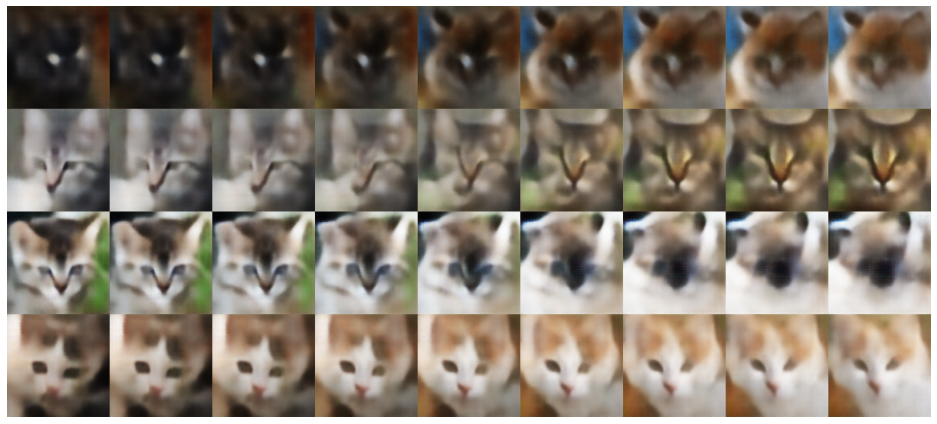

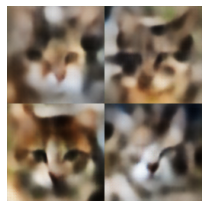


Epoch 141 | Reconstruction loss: 2354.972381402247 | KLD loss: 1446.4472205120585



Epoch 142 | Reconstruction loss: 2392.6836149796195 | KLD loss: 1539.1910749162946



Epoch 143 | Reconstruction loss: 2469.798488640637 | KLD loss: 1692.3181148552746



Epoch 144 | Reconstruction loss: 2379.559456392845 | KLD loss: 1704.6465611428207



Epoch 145 | Reconstruction loss: 2361.8412322050294 | KLD loss: 1622.7975280003518



Epoch 146 | Reconstruction loss: 2358.64395596522 | KLD loss: 1578.1085809743183



Epoch 147 | Reconstruction loss: 2349.357565174932 | KLD loss: 1519.0464642447714



Epoch 148 | Reconstruction loss: 2343.515255187609 | KLD loss: 1510.695222463667



Epoch 149 | Reconstruction loss: 2337.413299560547 | KLD loss: 1508.9073366911514



Epoch 150 | Reconstruction loss: 2331.4537129846417 | KLD loss: 1473.0620602435947


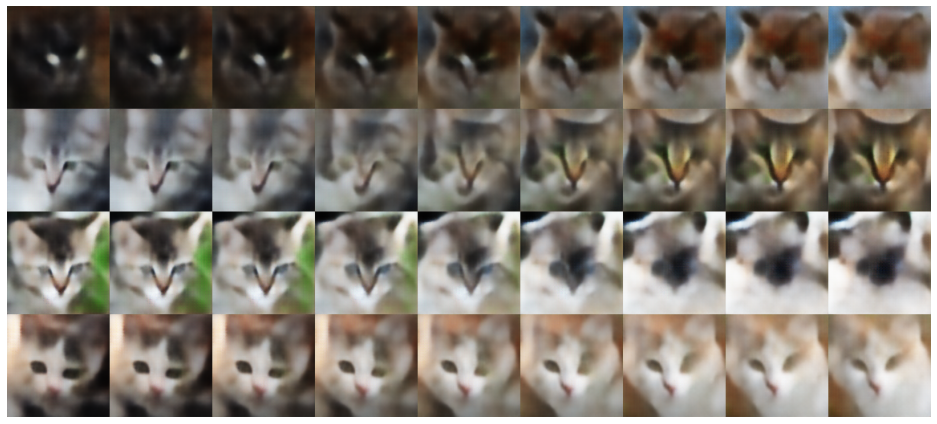

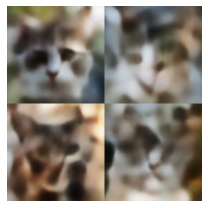


Epoch 151 | Reconstruction loss: 2344.24049462739 | KLD loss: 1499.0362937405982



Epoch 152 | Reconstruction loss: 2302.797936291428 | KLD loss: 1412.2925073848749



Epoch 153 | Reconstruction loss: 2374.213279961059 | KLD loss: 1504.1978378769775



Epoch 154 | Reconstruction loss: 2331.0694462557017 | KLD loss: 1525.604500906808



Epoch 155 | Reconstruction loss: 2342.2307743048814 | KLD loss: 1493.6305259562428



Epoch 156 | Reconstruction loss: 2327.636764431592 | KLD loss: 1495.656154656262



Epoch 157 | Reconstruction loss: 2307.421479408785 | KLD loss: 1481.43908407081



Epoch 158 | Reconstruction loss: 2334.9549613620925 | KLD loss: 1482.2137094817547



Epoch 159 | Reconstruction loss: 2299.7907477906033 | KLD loss: 1467.8864349933885



Epoch 160 | Reconstruction loss: 2319.198911678717 | KLD loss: 1486.2330926930683


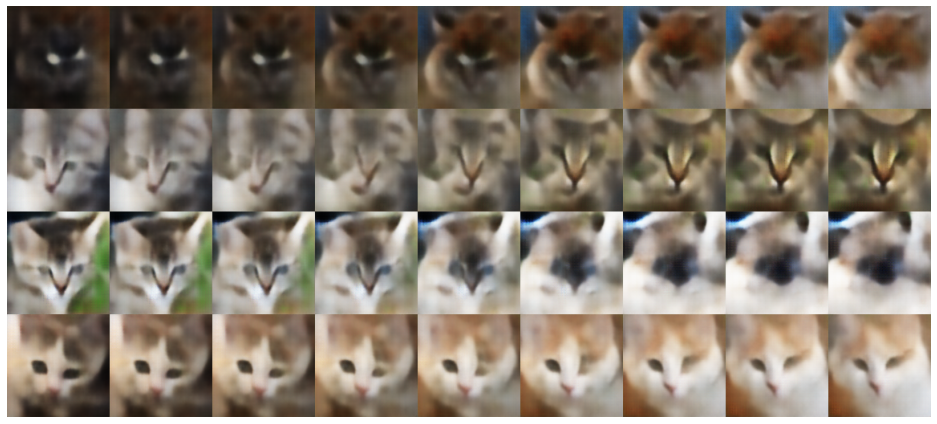

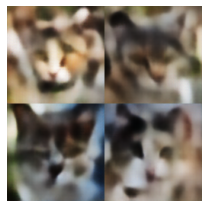


Epoch 161 | Reconstruction loss: 2286.4902720954847 | KLD loss: 1469.417809148753



Epoch 162 | Reconstruction loss: 2288.16585299095 | KLD loss: 1443.2432842373107



Epoch 163 | Reconstruction loss: 2265.9961515628033 | KLD loss: 1384.7322999942376



Epoch 164 | Reconstruction loss: 2344.145889756102 | KLD loss: 1497.5567196674228



Epoch 165 | Reconstruction loss: 2300.064740672615 | KLD loss: 1520.3321567322157



Epoch 166 | Reconstruction loss: 2292.6264221949605 | KLD loss: 1484.5627079365415



Epoch 167 | Reconstruction loss: 2269.521116837211 | KLD loss: 1454.1038702733767



Epoch 168 | Reconstruction loss: 2269.996342250279 | KLD loss: 1424.8365000849185



Epoch 169 | Reconstruction loss: 2271.2796740798476 | KLD loss: 1435.6367007427334



Epoch 170 | Reconstruction loss: 2292.196937134547 | KLD loss: 1490.2449126628615


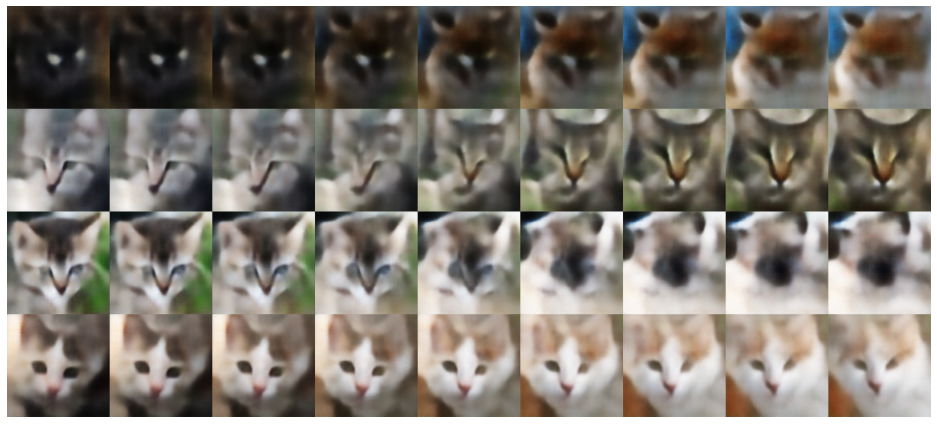

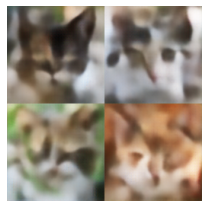


Epoch 171 | Reconstruction loss: 2275.3872932765794 | KLD loss: 1501.0384316770187



Epoch 172 | Reconstruction loss: 2277.908410492891 | KLD loss: 1492.9093254515844



Epoch 173 | Reconstruction loss: 2264.717557350301 | KLD loss: 1456.0644330326816



Epoch 174 | Reconstruction loss: 2269.8243157996894 | KLD loss: 1461.1135837720788



Epoch 175 | Reconstruction loss: 2264.6678510393417 | KLD loss: 1441.4839799774359



Epoch 176 | Reconstruction loss: 2287.267292662437 | KLD loss: 1454.277965285023



Epoch 177 | Reconstruction loss: 2273.557406597256 | KLD loss: 1485.4425907490415



Epoch 178 | Reconstruction loss: 2372.4330885987843 | KLD loss: 1593.1696517660012



Epoch 179 | Reconstruction loss: 2323.354523652829 | KLD loss: 1676.216960646351



Epoch 180 | Reconstruction loss: 2247.175478159271 | KLD loss: 1591.5038177300685


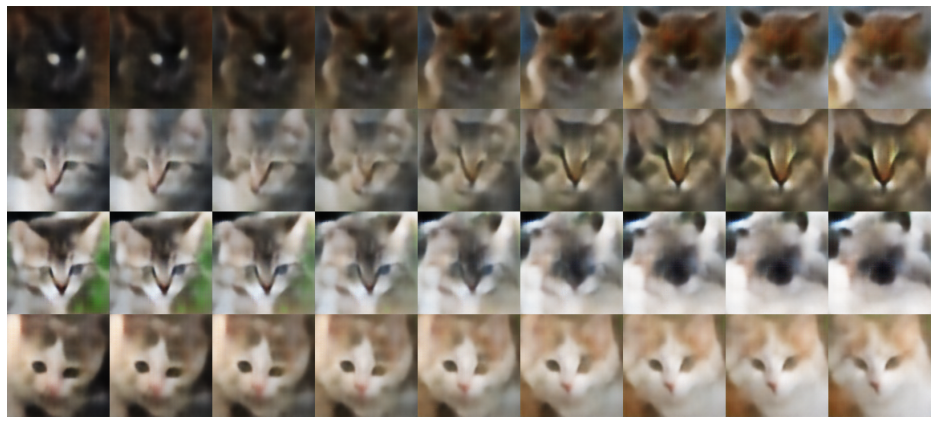

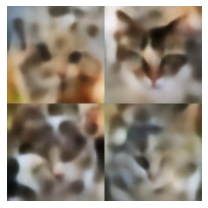


Epoch 181 | Reconstruction loss: 2234.5646891149677 | KLD loss: 1542.4442472280182



Epoch 182 | Reconstruction loss: 2234.5061550732726 | KLD loss: 1477.5580006475034



Epoch 183 | Reconstruction loss: 2251.3976440429688 | KLD loss: 1463.294896854377



Epoch 184 | Reconstruction loss: 2245.219244915506 | KLD loss: 1484.0030583920686



Epoch 185 | Reconstruction loss: 2230.3260973817814 | KLD loss: 1451.6401240188884



Epoch 186 | Reconstruction loss: 2222.752731228467 | KLD loss: 1400.0068145183302



Epoch 187 | Reconstruction loss: 2244.1633460003395 | KLD loss: 1478.8100506326427



Epoch 188 | Reconstruction loss: 2230.8277807768827 | KLD loss: 1432.9006112614034



Epoch 189 | Reconstruction loss: 2270.3077242833488 | KLD loss: 1530.0881667996046



Epoch 190 | Reconstruction loss: 2270.503434080515 | KLD loss: 1535.9042947899482


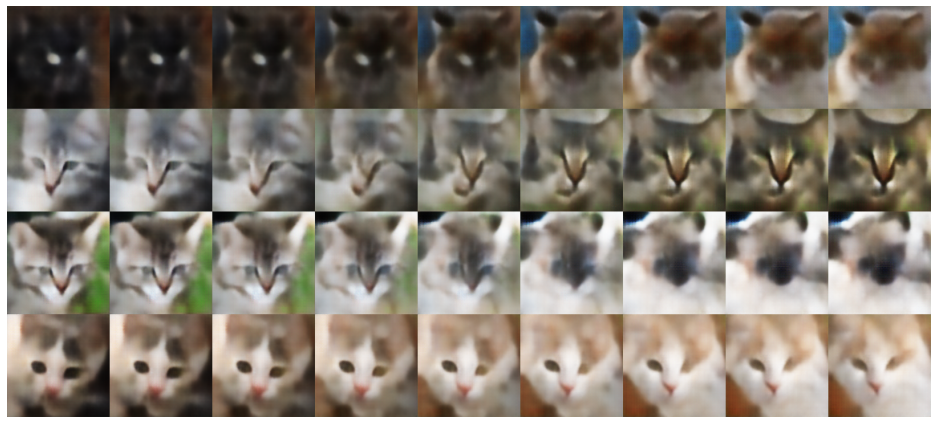

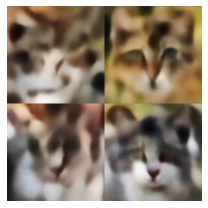


Epoch 191 | Reconstruction loss: 2220.8686248589747 | KLD loss: 1476.6125668353916



Epoch 192 | Reconstruction loss: 2217.157492690945 | KLD loss: 1448.6847100109787



Epoch 193 | Reconstruction loss: 2209.0520483929176 | KLD loss: 1416.429434829617



Epoch 194 | Reconstruction loss: 2200.6065698469647 | KLD loss: 1393.93350693602



Epoch 195 | Reconstruction loss: 2203.5645333047237 | KLD loss: 1395.7791738569367



Epoch 196 | Reconstruction loss: 2210.714520187852 | KLD loss: 1375.515638078962



Epoch 197 | Reconstruction loss: 2226.11921644507 | KLD loss: 1431.6224082804615



Epoch 198 | Reconstruction loss: 2189.897829043939 | KLD loss: 1384.3633057019724



Epoch 199 | Reconstruction loss: 2244.658736140091 | KLD loss: 1467.6392985278776



Epoch 200 | Reconstruction loss: 2170.8044365355686 | KLD loss: 1390.6623163637908


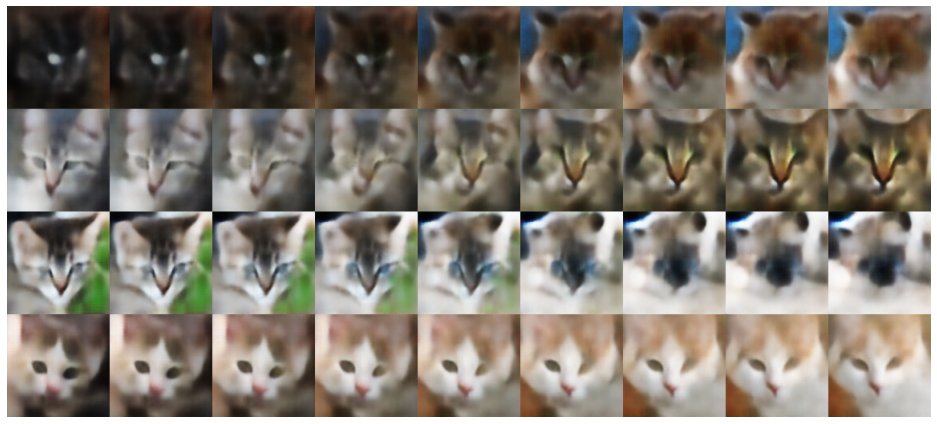

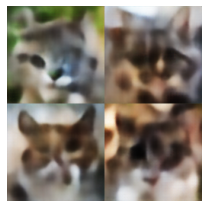


Epoch 201 | Reconstruction loss: 2197.7826069897005 | KLD loss: 1381.8959951459992


In [ ]:
def train_vae():
    vae = VAE()
    vae.cuda()

    epochs = 201
    batch_size = 8
    vae_optim = Adam(vae.parameters(), lr=1e-4)

    dataset = CatDataset(size=128)

    test_imgs_1 = torch.cat([dataset[i].unsqueeze(0) for i in (0, 34, 76, 1509)])
    test_imgs_2 = torch.cat([dataset[i].unsqueeze(0) for i in (734, 123, 512, 3634)])

    for ep in range(epochs):
        dataloader = DataLoader(dataset, shuffle=True, batch_size=batch_size)
        total_batches = 0
        rec_loss_avg = 0
        kld_loss_avg = 0

        if ep % 10 == 0:
            with torch.no_grad():
                z_1 = vae.encode(test_imgs_1.cuda())
                z_2 = vae.encode(test_imgs_2.cuda())
                x_int = []
                for i in range(9):
                    z = (i * z_1 + (8 - i) * z_2) / 8
                    x_int.append(vae.decode(z))
                x_int = torch.cat(x_int)

                visualise(x_int, rows=len(test_imgs_1))
                
                z_rand = torch.randn_like(z_1)
                x_int = vae.decode(z_rand)

                visualise(x_int, rows=len(test_imgs_1)//2)

        for i, batch in tqdm(enumerate(dataloader), total=(len(dataset) + batch_size) // batch_size):
            if len(batch) < batch_size:
                continue
            total_batches += 1
            x = batch.cuda()
            x_rec, kld = vae(x)
            img_elems = float(np.prod(list(batch.size())))
            kld_loss = kld.sum() / batch_size
            rec_loss = ((x_rec - x)**2).sum() / batch_size
            loss = rec_loss + 0.1 * kld_loss # https://openreview.net/forum?id=Sy2fzU9gl
            vae_optim.zero_grad()
            loss.backward()
            vae_optim.step()
            kld_loss_avg += kld_loss.item()
            rec_loss_avg += rec_loss.item()

        print(f"Epoch {ep+1} | Reconstruction loss: {rec_loss_avg / total_batches} | KLD loss: {kld_loss_avg / total_batches}")

train_vae()